#**Thông tin sinh viên**

* MSSV: 19521388
* Họ và tên: Hoàng Tiến Dũng
* Lớp môn học: CS116.M11
* Bài tập 13: Sử dụng đặc trưng từ pretrained model

#**Cài đặt thư viện, hàm và dữ liệu cần thiết**

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import cv2 as cv
from google.colab.patches import cv2_imshow
from keras.preprocessing import image
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.applications.vgg16 import preprocess_input

#**Load pretrained model VGG16**

In [ ]:
from keras.applications.vgg16 import VGG16

In [ ]:
model = VGG16()

553476096/553467096 [==============================] - 5s 0us/step


#**Load và rút trích đặc trưng các ảnh trong một thư mục**

In [ ]:
images_path = "/content/drive/MyDrive/CS116/Images/Data"

In [ ]:
def load_images(images_path):
  imgs = []
  for image in os.listdir(images_path):
    image_path = os.path.join(images_path, image)
    img = cv.imread(image_path)
    cv2_imshow(img)

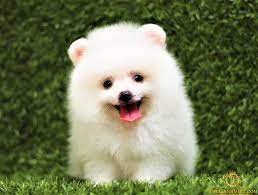

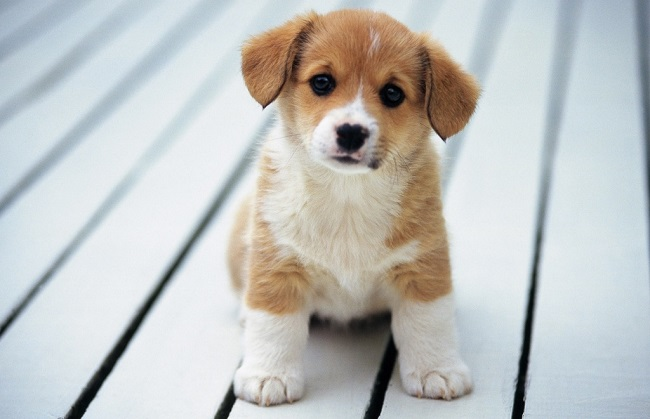

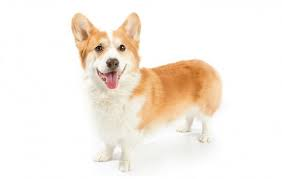

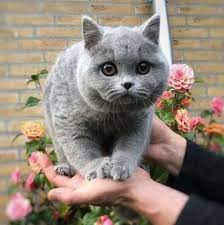

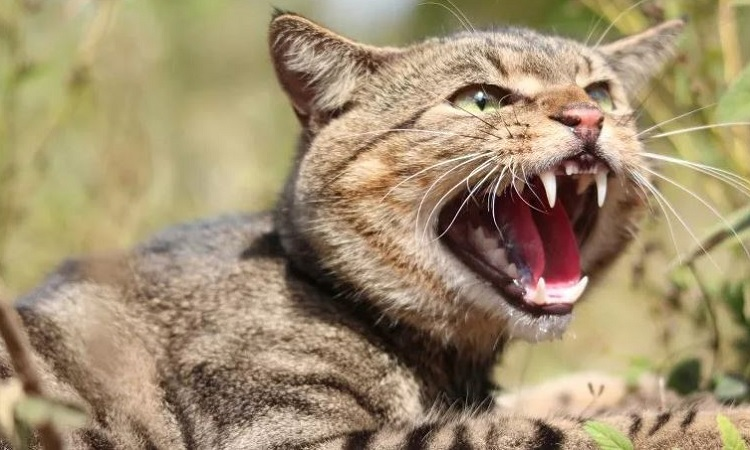

...

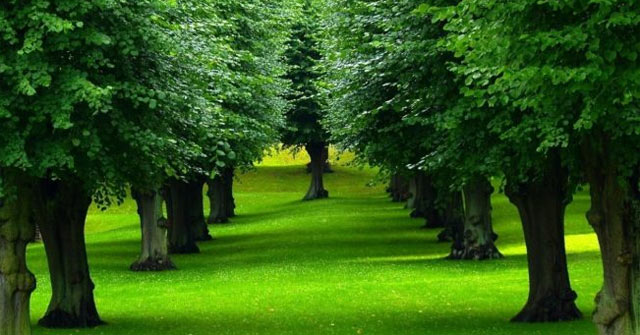

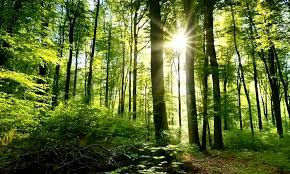

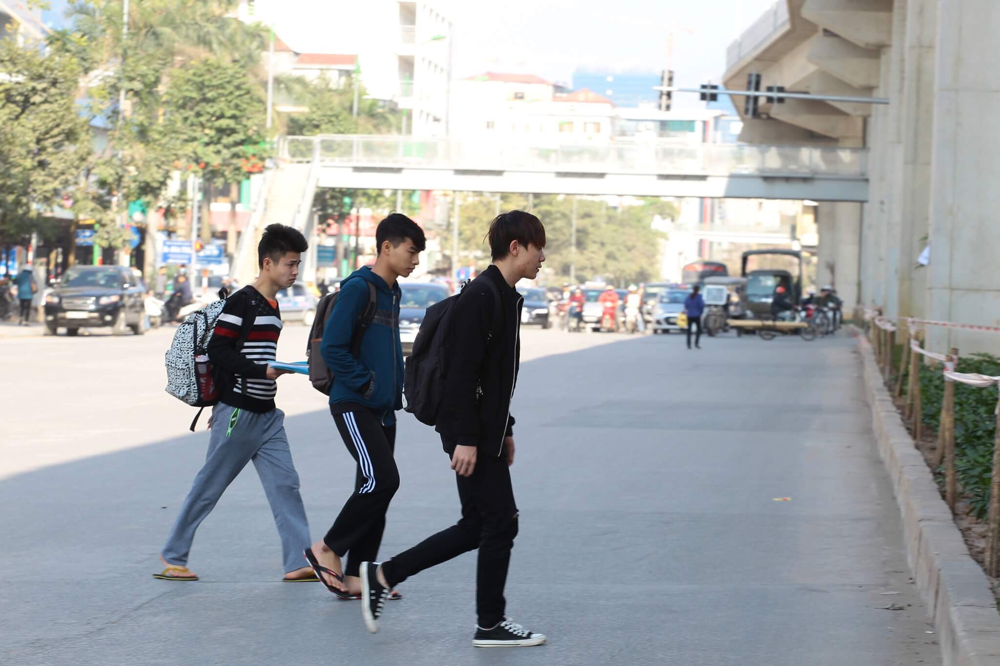

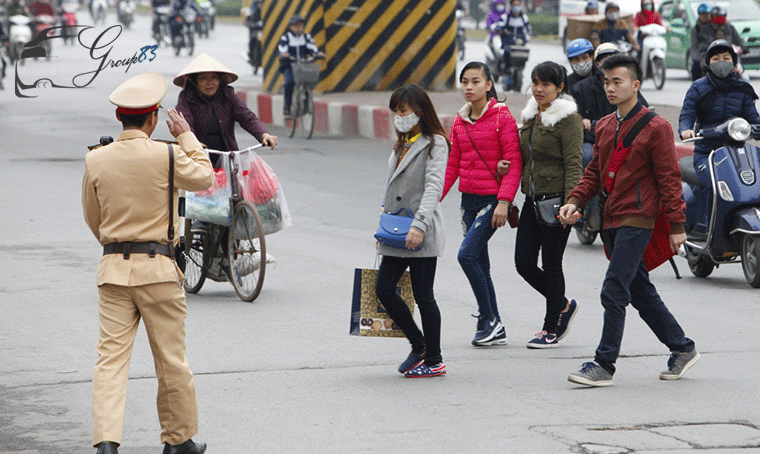

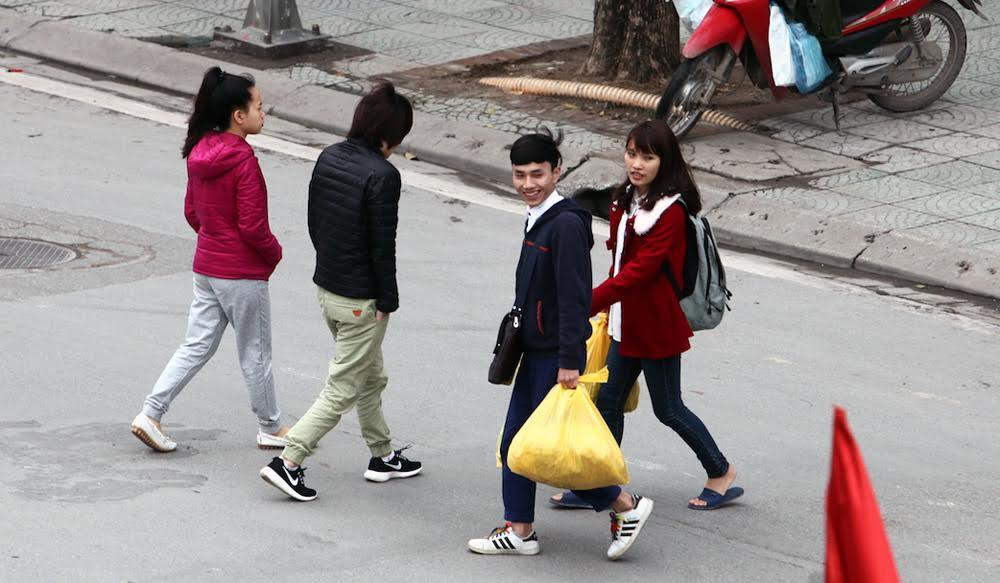

In [ ]:
load_images(images_path)

In [ ]:
def get_vgg16_features(images_path):
  feat_imgs = []
  dict_path = dict()
  i = 0
  for image in os.listdir(images_path):
    image_path = os.path.join(images_path, image)
    dict_path[i] = image_path
    i+=1
    print(image_path)
    img = load_img(str(image_path), target_size=(224,224))
    img_data = img_to_array(img)
    img_data = np.expand_dims(img_data, axis=0)
    img_data = preprocess_input(img_data)

    vgg16_feature = model.predict(img_data)
    vgg16_feature = np.array(vgg16_feature)
    feat_imgs.append(vgg16_feature.flatten())
  return dict_path, feat_imgs

In [ ]:
dict_img, vgg16_feature_list = get_vgg16_features(images_path)

/content/drive/MyDrive/CS116/Images/Data/tải xuốnga.jpg
/content/drive/MyDrive/CS116/Images/Data/day-cho-con-lam-quen-khi-ve-nha-moi.jpg
/content/drive/MyDrive/CS116/Images/Data/tải xuống.jpg
/content/drive/MyDrive/CS116/Images/Data/tải xuống2.jpg
/content/drive/MyDrive/CS116/Images/Data/VNE-Gene-JPG-9167-1637725767.jpg
/content/drive/MyDrive/CS116/Images/Data/meo-ba-tu.jpg
/content/drive/MyDrive/CS116/Images/Data/tải xuống3.jpg
/content/drive/MyDrive/CS116/Images/Data/Top-xe-o-to-vua-dep-vua-re-dang-ban-rat-chay-tai-thi-truong-Viet-Nam-2021-1-1634629692-968-width700height467.jpeg
/content/drive/MyDrive/CS116/Images/Data/10-mau-o-to-nhat-sap-ra-mat-thi-truong-nam-2022.jpg
/content/drive/MyDrive/CS116/Images/Data/131812962091273823.jpg
/content/drive/MyDrive/CS116/Images/Data/thuyet-minh-vai-tro-cua-cay-coi-1.jpg
/content/drive/MyDrive/CS116/Images/Data/tải xuốngaw.jpg
/content/drive/MyDrive/CS116/Images/Data/di-bo-pham-luat_0207092143.jpg
/content/drive/MyDrive/CS116/Ima

In [ ]:
np.array(vgg16_feature_list).shape

(15, 1000)

#**Đọc ảnh và rút trích đặc trưng ảnh truy vấn**

In [ ]:
img_query_1_path = "/content/drive/MyDrive/CS116/Images/Query/5c84171938a843baaeab5f17d573a774.jpg"
img_query_2_path = "/content/drive/MyDrive/CS116/Images/Query/bai-van-thuyet-minh-ve-vai-tro-cua-cay-coi-so-4-323611.jpg"
img_query_3_path = "/content/drive/MyDrive/CS116/Images/Query/images.jpg"
img_query_4_path = "/content/drive/MyDrive/CS116/Images/Query/meo-scottish.jpg"
img_query_5_path = "/content/drive/MyDrive/CS116/Images/Query/xe-oto-dien-tesla-model-s-muaxegiatot-vn.jpg"

In [ ]:
def get_query_feature(path):
  img_query_1 = load_img(str(path), target_size=(224,224))
  img_query_1 = img_to_array(img_query_1)
  cv2_imshow(cv.cvtColor(img_query_1, cv.COLOR_RGB2BGR))
  feat_img_query_1 = np.expand_dims(img_query_1, axis=0)
  feat_img_query_1 = preprocess_input(feat_img_query_1)
  vgg16_feature_query_1 = model.predict(feat_img_query_1)
  vgg16_feature = np.array(vgg16_feature_query_1)
  return vgg16_feature

#**Dùng mô hình KNN search với top K = 3 để tìm các đặc trưng gần với đặc trưng truy vấn nhất**

In [ ]:
def VisualImg(path):
  img = cv.imread(path)
  cv2_imshow(img)

In [ ]:
from sklearn.neighbors import NearestNeighbors

In [ ]:
kNN = NearestNeighbors(n_neighbors=5).fit(vgg16_feature_list)

##**1. Ảnh query 1**

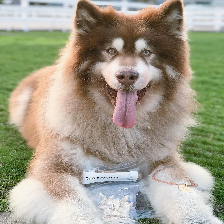

In [ ]:
img_query_1 = get_query_feature(img_query_1_path)

In [ ]:
distances, indices = kNN.kneighbors(img_query_1, 3)

In [ ]:
print(indices)

[[13 10 14]]


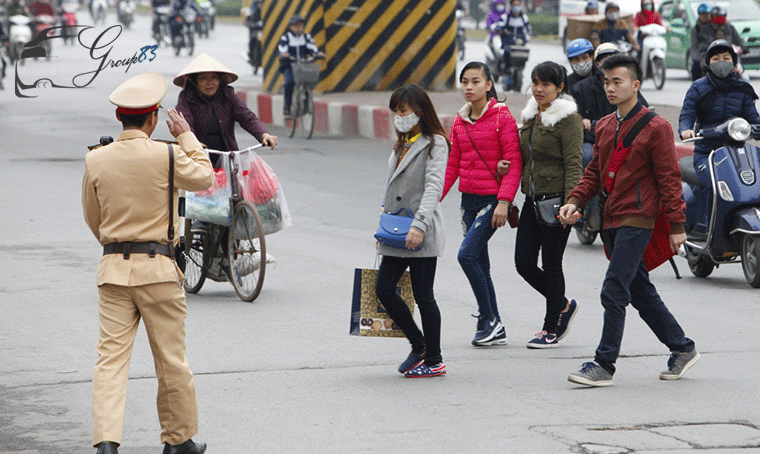

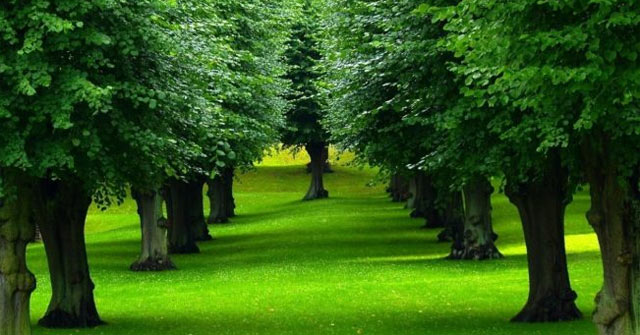

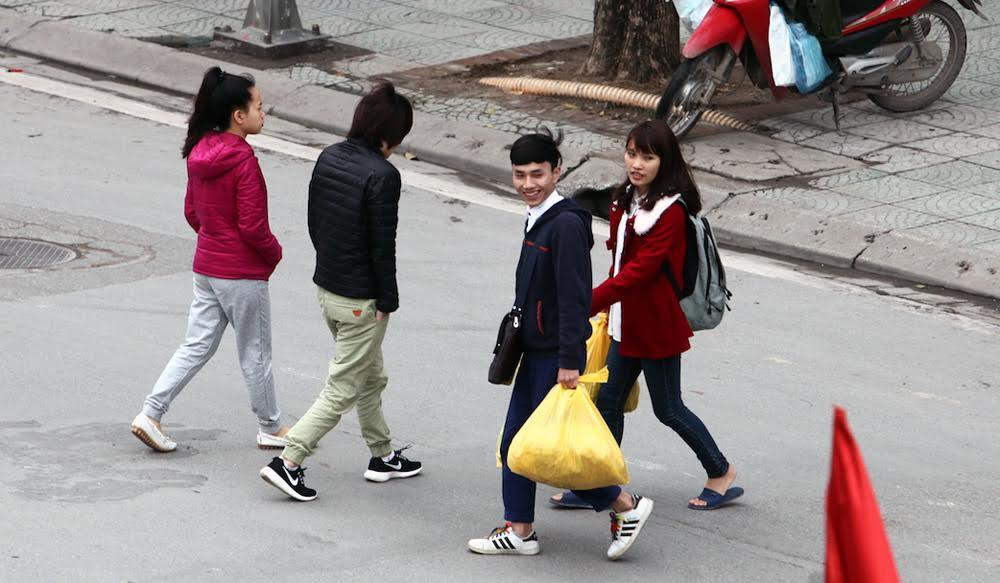

In [ ]:
for i in indices[0]:
  VisualImg(dict_img[i])

##**2. Ảnh query 2**

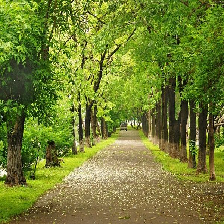

In [ ]:
img_query_2 = get_query_feature(img_query_2_path)

In [ ]:
distances, indices = kNN.kneighbors(img_query_2, 3)

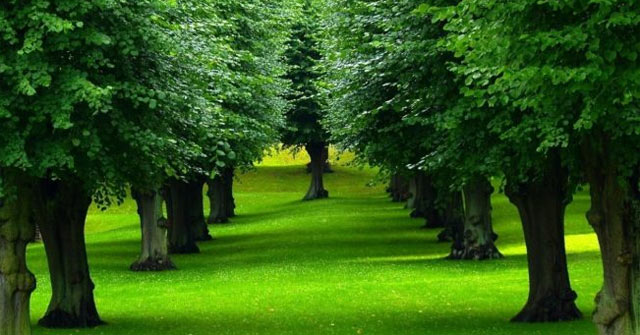

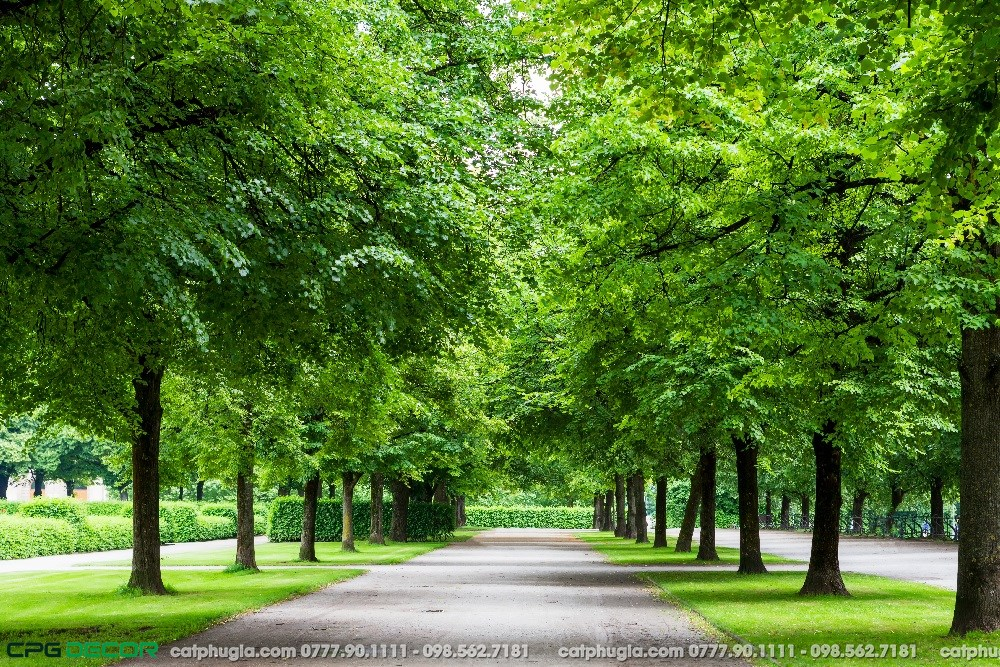

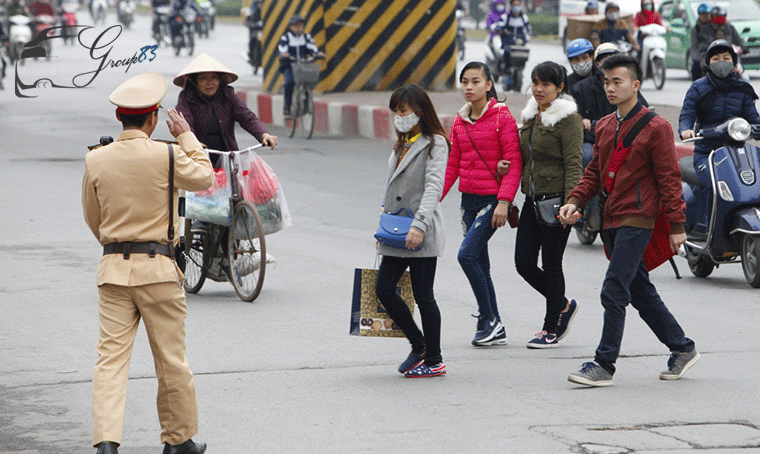

In [ ]:
for i in indices[0]:
  VisualImg(dict_img[i])

##**3. Ảnh query 3**

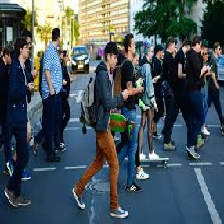

In [ ]:
img_query_3 = get_query_feature(img_query_3_path)

In [ ]:
distances, indices = kNN.kneighbors(img_query_3, 3)

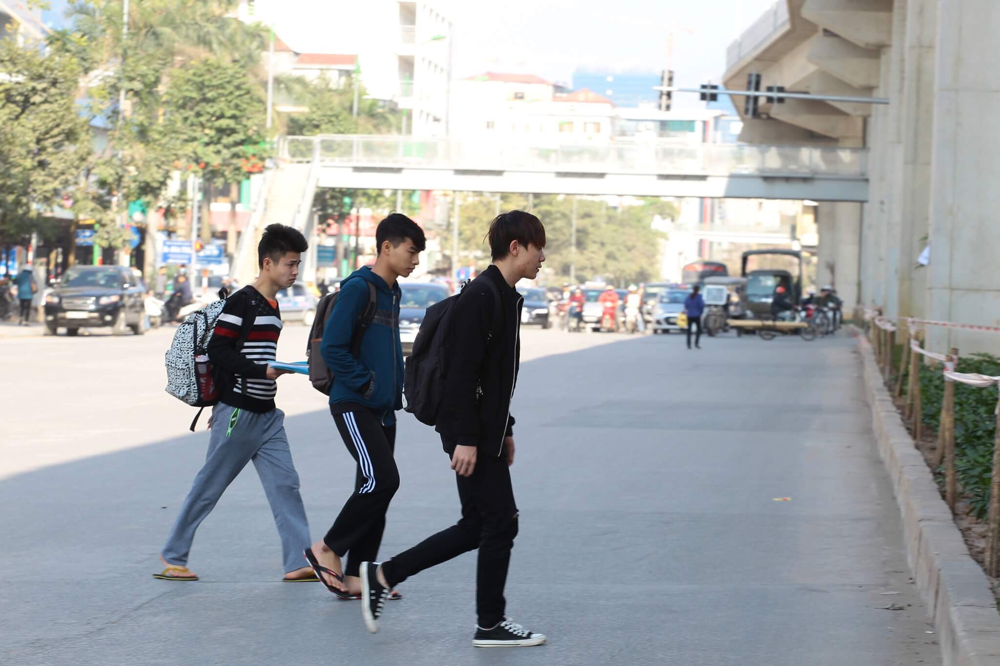

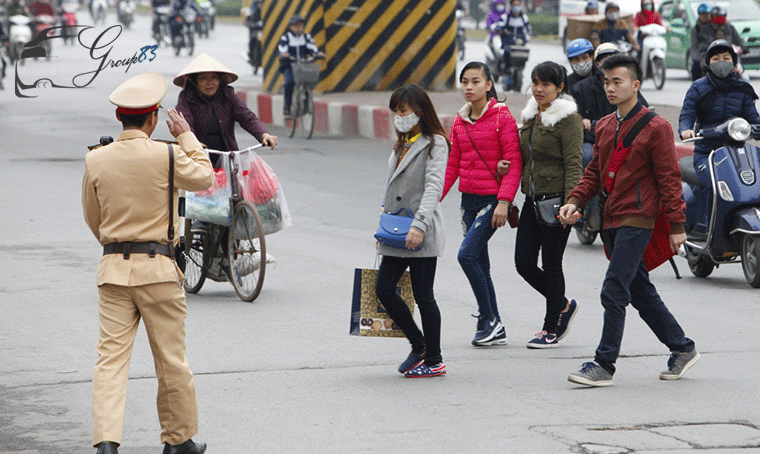

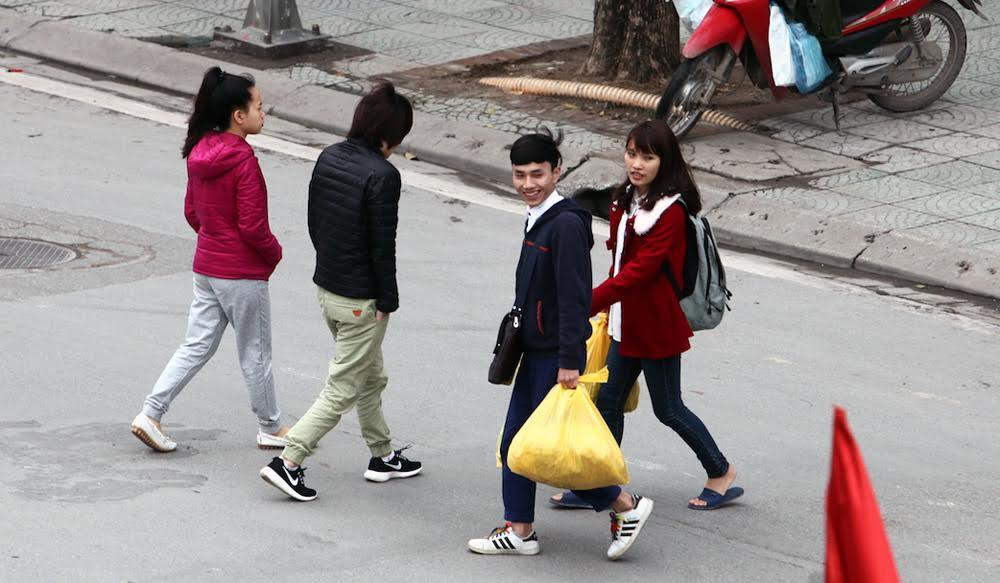

In [ ]:
for i in indices[0]:
  VisualImg(dict_img[i])

##**4. Ảnh query 4**

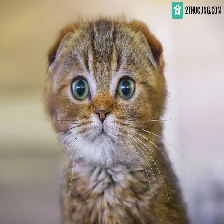

In [ ]:
img_query_4 = get_query_feature(img_query_4_path)

In [ ]:
distances, indices = kNN.kneighbors(img_query_4, 3)

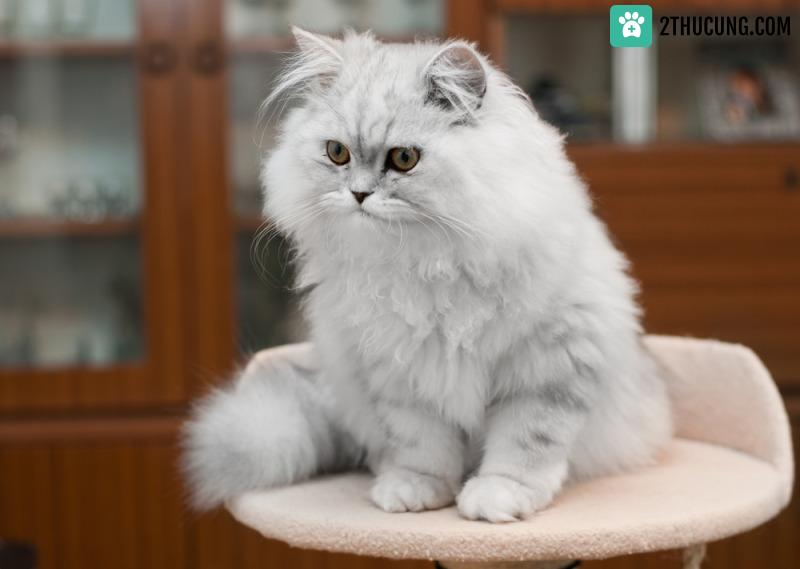

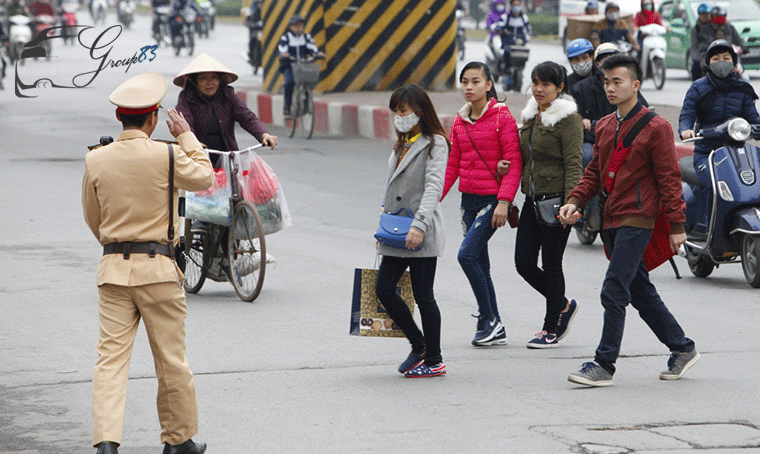

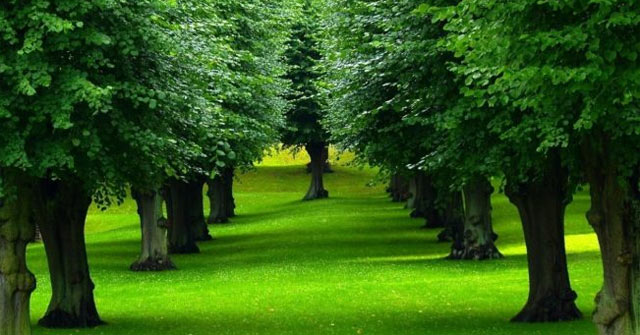

In [ ]:
for i in indices[0]:
  VisualImg(dict_img[i])

##**5. Ảnh query 5**

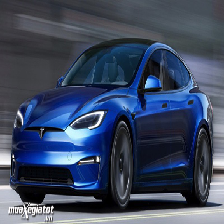

In [ ]:
img_query_5 = get_query_feature(img_query_5_path)

In [ ]:
distances, indices = kNN.kneighbors(img_query_5, 3)

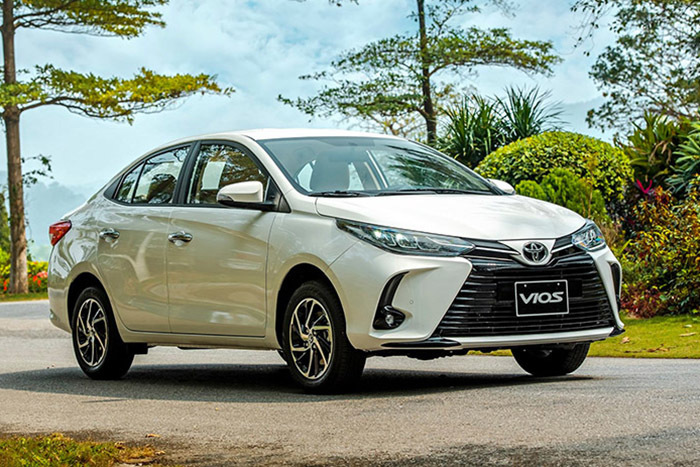

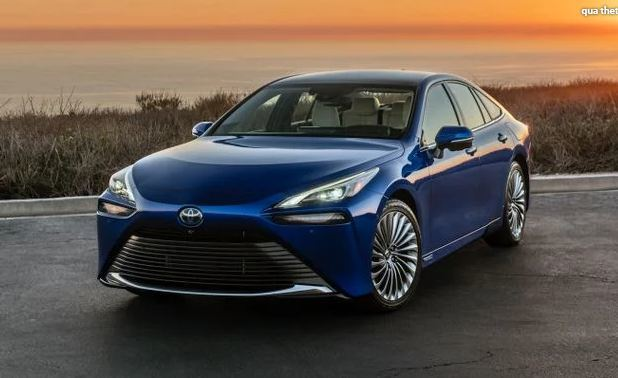

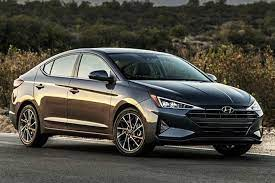

In [ ]:
for i in indices[0]:
  VisualImg(dict_img[i])